# Table of Content :
1. Data Preprocessing
2. Covid-19 Exploratory Data Analysis and Visualisation
   
   Covid-19 World Wide :
    - Covid-19 spread Analysis
    - Covid-19 Testing Analysis
    - Covid-19 Vaccination Analysis
    - Covid-19 Stringency Progression across Countries
   
   Covid-19 Continent Data :
    - Most Affected Continents
   
   Covid-19 Country Data :
    - Preprocess Country Data
    - Most Affected Countries
    - Testing Analysis in Countries
    - Vaccination of Countries
    - Sorting Counties Based on various Factors affecting Covid-19
    
   Covid-19 India :
    - Covid-19 Spread Analysis in India
    - Covid-19 Vaccination in India
    - Covid-19 Testing in India
    - Comparison between India and United States
    

# Import Packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Load the data

In [2]:
dataset=pd.read_csv("owid-covid-data.csv")
dataset.head()
print("SHAPE OF DATA :",dataset.shape)

SHAPE OF DATA : (118815, 63)


In [3]:
print(dataset.columns)

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [4]:
dataset.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative,excess_mortality
count,1.128930e+05,112890.000000,111875.000000,1.021760e+05,102331.000000,111875.000000,112298.000000,112295.000000,111285.000000,101594.000000,...,105273.000000,108492.000000,82215.000000,81021.000000,52876.000000,95736.000000,112711.000000,105368.000000,4132.000000,4207.000000
mean,1.391145e+06,6451.530649,6468.434818,3.551571e+04,145.873313,132.690822,17168.471699,82.527058,82.466447,361.482634,...,259.182766,8.009068,10.597189,32.735452,50.748384,3.024529,73.258603,0.726617,7.944584,14.965103
std,9.332739e+06,39399.087554,38988.362666,2.117348e+05,795.249922,743.256252,29504.586536,192.802545,162.890202,617.253252,...,119.294107,4.270664,10.505246,13.500364,31.753675,2.453364,7.543069,0.150235,16.013207,31.373302
min,1.000000e+00,-74347.000000,-6223.000000,1.000000e+00,-1918.000000,-232.143000,0.001000,-3125.829000,-272.971000,0.001000,...,79.370000,0.990000,0.100000,7.700000,1.188000,0.100000,53.280000,0.394000,-27.350000,-95.920000
25%,1.898000e+03,3.000000,9.000000,6.600000e+01,0.000000,0.000000,330.847250,0.278000,1.515000,10.016000,...,168.711000,5.310000,1.900000,21.600000,19.351000,1.300000,67.920000,0.602000,-1.680000,-1.735000
50%,1.954700e+04,91.000000,112.286000,5.840000e+02,2.000000,1.571000,2592.032500,10.429000,14.267000,65.950500,...,243.811000,7.110000,6.300000,31.400000,49.839000,2.400000,74.620000,0.744000,3.975000,5.560000
75%,2.050470e+05,913.000000,963.714000,4.990000e+03,19.000000,15.571000,20377.123000,80.191500,89.569000,434.254500,...,329.942000,10.080000,19.300000,41.100000,82.502000,3.861000,78.740000,0.848000,12.902500,21.265000
max,2.306016e+08,906034.000000,826428.571000,4.728852e+06,17976.000000,14723.000000,214134.061000,8620.690000,3385.473000,5970.009000,...,724.417000,30.530000,44.000000,78.100000,100.000000,13.800000,86.750000,0.957000,106.830000,372.820000


In [5]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118815 entries, 0 to 118814
Data columns (total 63 columns):
 #   Column                                 Non-Null Count   Dtype  
---  ------                                 --------------   -----  
 0   iso_code                               118815 non-null  object 
 1   continent                              113390 non-null  object 
 2   location                               118815 non-null  object 
 3   date                                   118815 non-null  object 
 4   total_cases                            112893 non-null  float64
 5   new_cases                              112890 non-null  float64
 6   new_cases_smoothed                     111875 non-null  float64
 7   total_deaths                           102176 non-null  float64
 8   new_deaths                             102331 non-null  float64
 9   new_deaths_smoothed                    111875 non-null  float64
 10  total_cases_per_million                112298 non-null  

# Data Preprocessing

In [6]:
# Delete Smoothed values of cases and Deaths
delete_columns=["new_cases_smoothed","new_deaths_smoothed","total_cases_per_million",
                "new_cases_smoothed_per_million","total_deaths_per_million","new_deaths_smoothed_per_million",
                "reproduction_rate","weekly_icu_admissions_per_million","weekly_hosp_admissions_per_million",
                "new_tests_smoothed","new_tests_smoothed_per_thousand","new_vaccinations_smoothed",
                "new_vaccinations_smoothed_per_million","excess_mortality_cumulative"]
dataset=dataset.drop(delete_columns,axis=1)
print("SHAPE OF DATA :",dataset.shape)

SHAPE OF DATA : (118815, 49)


In [7]:
data = dataset.copy()    #make a copy of dataset
# Remove non country items in Location Column   
data.drop(data[data["location"] == "World"].index,inplace=True)          #remove rows that have location as world 
data.drop(data[data["location"] == "European Union"].index,inplace=True) #remove rows that have location as Union 
data.drop(data[data["location"] == "International"].index,inplace=True)   #remove rows that have location as International 
# Remove Countries with null population
data.drop(data[data["population"].isna()].index,inplace=True)
continent=data["continent"].unique()
for i in continent:                                      #remove rows that have location as continent name
    data=data.drop(data[data["location"] == i].index)
data.reset_index(drop=True,inplace=True)
print("Shape of Data :",data.shape)
data.head()

Shape of Data : (113176, 49)


,iso_code,continent,location,date,total_cases,new_cases,total_deaths,new_deaths,new_cases_per_million,new_deaths_per_million,...,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality
0,AFG,Asia,Afghanistan,2020-02-24,5.0,5.0,NaN,NaN,0.126,NaN,...,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN
1,AFG,Asia,Afghanistan,2020-02-25,5.0,0.0,NaN,NaN,0.000,NaN,...,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN
2,AFG,Asia,Afghanistan,2020-02-26,5.0,0.0,NaN,NaN,0.000,NaN,...,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN
3,AFG,Asia,Afghanistan,2020-02-27,5.0,0.0,NaN,NaN,0.000,NaN,...,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN
4,AFG,Asia,Afghanistan,2020-02-28,5.0,0.0,NaN,NaN,0.000,NaN,...,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN


# Covid-19 EDA & Visualisation

# World Data

In [8]:
world_data = data.groupby(["date"])["total_cases","new_cases","total_deaths","new_deaths",
                                       "icu_patients","new_tests","total_tests","total_tests_per_thousand",
                                       "total_vaccinations","people_vaccinated","people_fully_vaccinated",
                                       "total_boosters","new_vaccinations","total_vaccinations_per_hundred"].sum()

world_data.reset_index(inplace=True)
print("shape of world_data",world_data.shape)
display("COVID DATA OF WORLD :",world_data)

shape of world_data (632, 15)


/home/syam/.local/lib/python3.6/site-packages/ipykernel_launcher.py:4: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



'COVID DATA OF WORLD :'

,date,total_cases,new_cases,total_deaths,new_deaths,icu_patients,new_tests,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,total_vaccinations_per_hundred
0,2020-01-01,0.0,0.0,0.0,0.0,0.0,28.0,2.800000e+01,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.00
1,2020-01-02,0.0,0.0,0.0,0.0,0.0,108.0,1.340000e+02,0.002,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.00
2,2020-01-03,0.0,0.0,0.0,0.0,0.0,94.0,2.300000e+02,0.002,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.00
3,2020-01-04,0.0,0.0,0.0,0.0,0.0,116.0,3.460000e+02,0.004,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.00
4,2020-01-05,0.0,0.0,0.0,0.0,0.0,87.0,4.260000e+02,0.004,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,2021-09-19,228539297.0,358548.0,4691834.0,6011.0,31338.0,5161753.0,1.727717e+09,89217.488,5.447360e+09,2.013340e+09,1.268072e+09,22798592.0,21301133.0,8415.92
628,2021-09-20,229079692.0,540395.0,4699988.0,8154.0,25887.0,2966271.0,1.394406e+09,65807.771,5.582120e+09,2.111472e+09,1.318240e+09,22673037.0,18985416.0,9443.51
629,2021-09-21,229548386.0,468694.0,4709086.0,9098.0,25571.0,1082013.0,1.920405e+08,12918.836,5.531126e+09,2.025785e+09,1.303958e+09,23477780.0,24602921.0,10317.22
630,2021-09-22,230086156.0,537770.0,4719163.0,10077.0,24592.0,687178.0,1.422550e+08,11761.852,5.188232e+09,1.856624e+09,1.173618e+09,23765794.0,19863281.0,9241.47


### Worldwide Total Cases and Total Deaths Over Time

In [9]:
fig=px.line(world_data,x="date",y=["total_cases","total_deaths"],
            title="Worldwide Total Cases and Total Deaths Over Time")
fig.show()

### World-wide Daily Covid_19 Cases

In [10]:
fig=px.line(world_data,x="date",y=["new_cases","new_deaths"],labels={"value":"Count"},
            title="Worldwide Cases and Deaths Daily")
fig.show()

### World-wide Vaccination Data from starting of Vaccination 

In [11]:
start_date = "2020-12-12"                    #Starting Date of Vaccination
end_date = "2021-09-23"
mask = (world_data['date'] > start_date) & (world_data['date'] <= end_date)
vaccination_start = world_data.loc[mask]
vaccination_start.reset_index(drop=True,inplace=True)
vaccination_start.head()

,date,total_cases,new_cases,total_deaths,new_deaths,icu_patients,new_tests,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,total_vaccinations_per_hundred
0,2020-12-13,72466580.0,529569.0,1671505.0,7749.0,43529.0,4695173.0,801066030.0,27066.940,86465.0,86465.0,0.0,0.0,0.0,0.13
1,2020-12-14,72999599.0,533019.0,1680593.0,9088.0,46230.0,4774442.0,686071954.0,26650.977,5.0,5.0,0.0,0.0,0.0,0.00
2,2020-12-15,73648370.0,648771.0,1694457.0,13864.0,46417.0,5603493.0,760959178.0,25059.195,1529223.0,29223.0,0.0,0.0,718.0,0.12
3,2020-12-16,74375996.0,727626.0,1708250.0,13793.0,46510.0,6368380.0,774475601.0,26975.248,3025.0,3025.0,0.0,0.0,2300.0,0.01
4,2020-12-17,75113847.0,737851.0,1721693.0,13443.0,46363.0,6755853.0,819164938.0,27741.620,7211.0,7211.0,0.0,0.0,4186.0,0.02


### Worldwide Daily Vaccinations Over Time

In [12]:
fig=px.line(vaccination_start,x="date",y="new_vaccinations",
            title="Worldwide Daily Vaccinations Over Time")
fig.show()

### World-wide Total Vaccinations Over Time

In [13]:
fig=px.line(vaccination_start,x="date",y="total_vaccinations",
            title="World-wide Total Vaccinations Over Time")
fig.show()

### Vaccination Dose Administered World-wide

In [14]:
fig=px.line(vaccination_start,x="date",y=["people_vaccinated", "people_fully_vaccinated","total_boosters"],
            title="Vaccination Doses Administered World Wide",labels={"value":"Count"})
fig.show()

###  Daily Covid_19 Testing vs New Cases

In [15]:
fig=px.line(world_data ,x="date",y=["new_tests", "new_cases"],
            title="Relation Between Daily Testing and Daily Cases",labels={"value":"Count"})
fig.show()

### World-Wide Stringency Index Over Time

In [16]:
figure = px.choropleth(data,locations="location",locationmode="country names",color="stringency_index",
                     animation_frame="date",hover_data=["continent","new_cases","population"])
figure.update_layout(title="World Wide Stringency Index Over Time",template="plotly_dark")
figure.show()

# Continent Data

In [17]:
continent=data["continent"].unique()  
print("List of Continents:",continent)

List of Continents: ['Asia' 'Europe' 'Africa' 'North America' 'South America' 'Oceania']


### Total Cases ,Deaths and Recovered Patients Based on Continent

In [18]:
cases_continent = data.groupby("continent")["total_cases"].sum()    #Acessing total cases for each continent
deaths_continent = data.groupby("continent")["total_deaths"].sum()  #Acessing total deaths for each contient
deaths_con = deaths_continent[continent].values
cases_con = cases_continent[continent].values
recovered_con = np.subtract(cases_con,deaths_con)               #Acessing total recoverd cases for each continent
continent_total=pd.DataFrame({"Continent":continent,"Total_cases":cases_con,"Total_death":deaths_con,
                              "Total_recovered":recovered_con})

continent_total.sort_values("Total_cases",axis = 0, ascending=False, inplace = True)    
continent_total.reset_index(drop=True)
display("Continent Data",continent_total)

'Continent Data'

,Continent,Total_cases,Total_death,Total_recovered
0,Asia,1.384330e+10,209843656.0,1.363346e+10
1,Europe,1.330921e+10,324170578.0,1.298504e+10
3,North America,1.204962e+10,288011954.0,1.176161e+10
4,South America,8.533176e+09,272472034.0,8.260704e+09
2,Africa,1.656080e+09,42289221.0,1.613790e+09
5,Oceania,2.151631e+07,453094.0,2.106322e+07


### Percentage of Confirmed Cases on each Continent

<AxesSubplot:title={'center':'Percentage of Confirmed Cases on Each Continent'}, ylabel='Total_cases'>

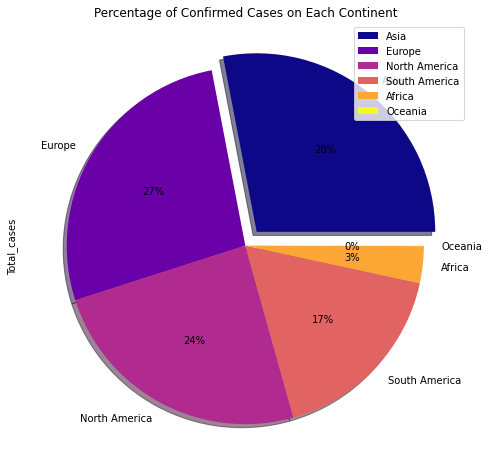

In [19]:
my_explode = (0.1,0.0,0.0,0.0,0.0,0.0)
my_labels = continent_total["Continent"]
continent_total.plot(kind= "pie",y = 'Total_cases',autopct='%1.0f%%',labels=continent_total["Continent"],
                     figsize=(8,10),explode=my_explode,legend=True,shadow=True,
                     title="Percentage of Confirmed Cases on Each Continent",colormap='plasma')

### Percentage of Confirmed Deaths on each Continent

<AxesSubplot:title={'center':'Percentage of Confirmed Deaths on Each Continent'}, ylabel='Total_death'>

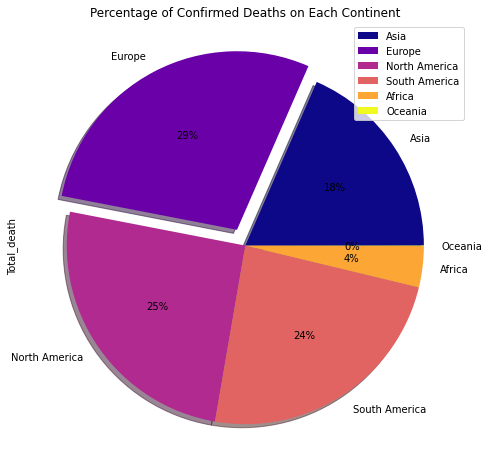

In [20]:
my_explode = (0.0,0.1,0.0,0.0,0.0,0.0)
my_labels = continent_total["Continent"]
continent_total.plot(kind = "pie",y = 'Total_death',autopct='%1.0f%%',labels = continent_total["Continent"],
                     figsize = (8,10),explode = my_explode,legend=True,shadow = True,
                     title = "Percentage of Confirmed Deaths on Each Continent",colormap='plasma')

# Country Data

### Countries with No Covid Cases

In [21]:
no_total_cases = pd.DataFrame(data.groupby("location")["new_cases"].sum())
covid_free_countries = no_total_cases[no_total_cases["new_cases"] == 0].reset_index()
covid_free_countries.rename(columns={"new_cases":"Total_cases"},inplace=True)
print("NUMBER OF COUNTRIES WITH NO COVID CASES :",len(covid_free_countries))
display(covid_free_countries)

NUMBER OF COUNTRIES WITH NO COVID CASES : 30


,location,Total_cases
0,Anguilla,0.0
1,Aruba,0.0
2,Bermuda,0.0
3,Bonaire Sint Eustatius and Saba,0.0
4,British Virgin Islands,0.0
5,Cayman Islands,0.0
6,Cook Islands,0.0
7,Curacao,0.0
8,Faeroe Islands,0.0
9,Falkland Islands,0.0


### Preprocess Country Data

In [22]:
#Drop countries with no covid cases
covid_free = covid_free_countries["location"].unique() 
for location in covid_free:
    data = data.drop(data[data["location"] == location].index)
    
country=data["location"].unique()    #unique country locations
location = country.tolist()          #convert to list

#Function to add feature values to dataset
def preprocess (data,label):
    """
    INPUTS :
    data   : input dataframe
    label  : feature name
    _____________________________________________________
    OUTPUTS :
    feature : value of each feature sorted by country
    _____________________________________________________
    """
    feature =[]
    for loc in country:
        out = pd.DataFrame(data[data["location"] == loc][label])
        out = out.sort_values(label,axis=0,ascending=False).head(1)
        feature.append(out[label].values[0])
    return feature

#features to add
values = ["total_cases","total_deaths","population","total_tests","total_tests_per_thousand","total_vaccinations",
          "people_vaccinated", "people_fully_vaccinated", "total_boosters","total_vaccinations_per_hundred",
          "population_density","median_age","aged_65_older","aged_70_older", "gdp_per_capita", "extreme_poverty",
          "cardiovasc_death_rate","diabetes_prevalence", "female_smokers","male_smokers", "handwashing_facilities", 
          "hospital_beds_per_thousand","life_expectancy", "human_development_index"]

processed_dict = {}

#function call
for i in values:
    dict_value=preprocess(data,i)
    processed_dict[i] = dict_value
    
# dictionary for country names
country_dict={"Country":location}
#concat two dictionaries
new_dict = {**country_dict,**processed_dict}
#create a new Dataframe
country_total=pd.DataFrame(new_dict)
display("Covid Data based on Country ::",country_total)

'Covid Data based on Country ::'

,Country,total_cases,total_deaths,population,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
0,Afghanistan,154800.0,7199.0,39835428.0,NaN,NaN,3133227.0,773002.0,430744.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.50,64.83,0.511
1,Albania,165864.0,2609.0,2872934.0,737014.0,256.537,1674093.0,926652.0,747441.0,NaN,...,11803.431,1.1,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795
2,Algeria,202283.0,5748.0,44616626.0,NaN,NaN,9989662.0,5815039.0,4174623.0,NaN,...,13913.839,0.5,278.364,6.73,0.7,30.4,83.741,1.90,76.88,0.748
3,Andorra,15156.0,130.0,77354.0,212987.0,2753.406,93430.0,51599.0,41831.0,NaN,...,NaN,NaN,109.135,7.97,29.0,37.8,NaN,NaN,83.73,0.868
4,Angola,53840.0,1460.0,33933611.0,NaN,NaN,2820134.0,1836547.0,983587.0,NaN,...,5819.495,NaN,276.045,3.94,NaN,NaN,26.664,NaN,61.15,0.581
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,Venezuela,358462.0,4346.0,28704947.0,NaN,NaN,11094206.0,6822809.0,4271397.0,NaN,...,16745.022,NaN,204.850,6.47,NaN,NaN,NaN,0.80,72.06,0.711
189,Vietnam,728435.0,18017.0,98168829.0,18407857.0,187.512,35675840.0,28745680.0,6930160.0,NaN,...,6171.884,2.0,245.465,6.00,1.0,45.9,85.847,2.60,75.40,0.704
190,Yemen,8830.0,1664.0,30490639.0,NaN,NaN,322934.0,308025.0,14909.0,NaN,...,1479.147,18.8,495.003,5.35,7.6,29.2,49.542,0.70,66.12,0.470
191,Zambia,208715.0,3641.0,18920657.0,2398197.0,126.750,670361.0,311049.0,291947.0,NaN,...,3689.251,57.5,234.499,3.94,3.1,24.7,13.938,2.00,63.89,0.584


In [23]:
# Add Case fatality ratio for countries to data
case_fatality_ratio = country_total["total_deaths"]/country_total["total_cases"]
# Add Mortality ratio for countries to data
mortality_ratio = country_total["total_deaths"]/country_total["population"]
country_total = country_total.assign(Case_fatality_ratio = case_fatality_ratio,Mortality_ratio = mortality_ratio)

In [24]:
print("Featue Names ::",country_total.columns)

Featue Names :: Index(['Country', 'total_cases', 'total_deaths', 'population', 'total_tests',
       'total_tests_per_thousand', 'total_vaccinations', 'people_vaccinated',
       'people_fully_vaccinated', 'total_boosters',
       'total_vaccinations_per_hundred', 'population_density', 'median_age',
       'aged_65_older', 'aged_70_older', 'gdp_per_capita', 'extreme_poverty',
       'cardiovasc_death_rate', 'diabetes_prevalence', 'female_smokers',
       'male_smokers', 'handwashing_facilities', 'hospital_beds_per_thousand',
       'life_expectancy', 'human_development_index', 'Case_fatality_ratio',
       'Mortality_ratio'],
      dtype='object')


### Sort Countries based on Number of Covid Cases

In [25]:
country_cases_sorted = country_total.sort_values("total_cases", axis = 0, ascending = False)
country_cases_sorted.reset_index(drop=True,inplace=True)
display("COUNTRIES WITH MOST NUMBER OF CASES :",country_cases_sorted)

'COUNTRIES WITH MOST NUMBER OF CASES :'

,Country,total_cases,total_deaths,population,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,...,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,Case_fatality_ratio,Mortality_ratio
0,United States,42672241.0,684349.0,3.329151e+08,558104328.0,1676.417,387821704.0,212564346.0,182587334.0,2370839.0,...,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,0.016037,0.002056
1,India,33594803.0,446368.0,1.393409e+09,553621766.0,397.315,837239837.0,621209052.0,216030785.0,NaN,...,282.280,10.39,1.9,20.6,59.550,0.53,69.66,0.645,0.013287,0.000320
2,Brazil,21308178.0,592964.0,2.139934e+08,31716527.0,148.213,227164873.0,147908426.0,83816644.0,NaN,...,177.961,8.11,10.1,17.9,NaN,2.20,75.88,0.765,0.027828,0.002771
3,United Kingdom,7601598.0,136156.0,6.820711e+07,263671147.0,3865.743,93274224.0,48674154.0,44600070.0,NaN,...,122.137,4.28,20.0,24.7,NaN,2.54,81.32,0.932,0.017911,0.001996
4,Russia,7248572.0,197834.0,1.459120e+08,187347905.0,1283.979,88567925.0,47285157.0,41282768.0,NaN,...,431.297,6.18,23.4,58.3,NaN,8.05,72.58,0.824,0.027293,0.001356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,Vanuatu,4.0,1.0,3.144640e+05,NaN,NaN,57184.0,42840.0,14344.0,NaN,...,546.300,12.02,2.8,34.5,25.209,NaN,70.47,0.609,0.250000,0.000003
189,Marshall Islands,4.0,NaN,5.961800e+04,NaN,NaN,NaN,NaN,NaN,NaN,...,557.793,30.53,NaN,NaN,82.502,2.70,73.70,0.704,NaN,NaN
190,Samoa,3.0,NaN,2.001440e+05,NaN,NaN,149431.0,99163.0,50268.0,NaN,...,348.977,9.21,16.7,38.1,NaN,NaN,73.32,0.715,NaN,NaN
191,Kiribati,2.0,NaN,1.213880e+05,NaN,NaN,31332.0,24429.0,6903.0,NaN,...,434.657,22.66,35.9,58.9,NaN,1.90,68.37,0.630,NaN,NaN


### Top 10 Countries with Most Cases

In [26]:
top_10_cases = country_cases_sorted.head(10)

fig = px.bar(top_10_cases, x="Country", y=["total_cases","total_deaths"], barmode="group",
             title="Top 10 Countries with Most Cases",labels={"value":"Count"})
fig.show()

### Top 10 Countries with Most Death Counts

In [27]:
country_death_sorted = country_total.sort_values("total_deaths", axis = 0, ascending = False)  
country_death_sorted.reset_index(drop=True,inplace=True)
top_10_deaths = country_death_sorted.head(10)
display("Top 10 Countries with Most Death Counts",top_10_deaths[top_10_deaths.columns[:5]])

fig = px.bar(top_10_deaths, x="Country", y=["total_deaths","total_cases"], barmode="group",
             title="Top 10 Countries with Most Deaths")
fig.show()

'Top 10 Countries with Most Death Counts'

,Country,total_cases,total_deaths,population,total_tests
0,United States,42672241.0,684349.0,3.329151e+08,558104328.0
1,Brazil,21308178.0,592964.0,2.139934e+08,31716527.0
2,India,33594803.0,446368.0,1.393409e+09,553621766.0
3,Mexico,3608976.0,274139.0,1.302622e+08,9864382.0
4,Peru,2170475.0,199156.0,3.335942e+07,5037992.0
5,Russia,7248572.0,197834.0,1.459120e+08,187347905.0
6,Indonesia,4201559.0,141114.0,2.763618e+08,24548760.0
7,United Kingdom,7601598.0,136156.0,6.820711e+07,263671147.0
8,Italy,4649906.0,130551.0,6.036747e+07,89420490.0
9,Colombia,4946811.0,126032.0,5.126584e+07,25029645.0


## Testing Data of Countries

### Country with Max-Covid Test Rates

In [28]:
#Calculating Covid Test Rate for Each Country
country_total["test_rate"] = country_total["total_tests"]/country_total["population"]
max_test_rates = country_total.sort_values("test_rate",axis = 0, ascending = False)[:10]
max_test_rates.reset_index(drop=True,inplace=True)

fig = px.bar(max_test_rates, x="test_rate", y="Country",
             title="Top 10 Countries with Maximum Covid Test Rates", height=600, text="test_rate",
             orientation="h",color="test_rate",hover_data=["population"])
fig.update_layout(yaxis={'categoryorder':'total ascending'})
fig.show()

### Case Fatality Rate vs Median Age of Different Countries

In [29]:
# countries with high median age have low case fatality rate
high_median = country_total.sort_values("median_age",axis=0,ascending=False)
high_median_age = high_median[["Country","median_age","life_expectancy","Case_fatality_ratio"]].dropna().reset_index(drop=True)[:20]

fig = px.scatter(high_median_age, x="median_age", y="Case_fatality_ratio",hover_name="Country",color="Country", 
                  size="Case_fatality_ratio",labels={"median_age":"High median age"},size_max=30,
                 title="Case Fatality Rate in Counries with High Median of Age")
fig.show()

In [30]:
# countries with low median age have high case fatality rates
low_median = country_total.sort_values("median_age",axis=0,ascending=True)
low_median_age = low_median[["Country","median_age","life_expectancy","Case_fatality_ratio"]].dropna().reset_index(drop=True)[:20]

fig = px.scatter(low_median_age, x="median_age", y="Case_fatality_ratio",hover_name="Country",color="Country", 
                  size="Case_fatality_ratio",labels={"median_age":"Low median age"},size_max=30,
                 title="Case Fatality Rate in Counries with Low Median of Age")
fig.show()

### Comparing Cases in Countries with High Hand Washing Facilities and Low hand Washing Facilities

In [31]:
# Top 10 countries with high handwashing_facilities
high_handwash_facility = country_total.sort_values("handwashing_facilities",axis=0,ascending=False).reset_index(drop=True)[:10]
display("Countries With Better Handwashing Facilities",high_handwash_facility[["Country","handwashing_facilities","total_cases"]])

# Top 10 countries with low handwashing_facilities
low_handwash_facility  = country_total.sort_values("handwashing_facilities",axis=0,ascending=True).reset_index(drop=True)[:10]
display("Countries With Low Handwashing Facilities",low_handwash_facility[["Country","handwashing_facilities","total_cases"]])

'Countries With Better Handwashing Facilities'

,Country,handwashing_facilities,total_cases
0,Kazakhstan,98.999,947482.0
1,Serbia,97.719,893023.0
2,Oman,97.400,303551.0
3,Bosnia and Herzegovina,97.164,230212.0
4,Maldives,95.803,84103.0
5,Iraq,94.576,1987352.0
6,Armenia,94.043,255648.0
7,Thailand,90.670,1524613.0
8,El Salvador,90.650,102024.0
9,Belize,90.083,19429.0


'Countries With Low Handwashing Facilities'

,Country,handwashing_facilities,total_cases
0,Liberia,1.188,5915.0
1,Lesotho,2.117,14395.0
2,Cameroon,2.735,85414.0
3,Democratic Republic of Congo,4.472,56463.0
4,Rwanda,4.617,96337.0
5,Chad,5.818,5031.0
6,Burundi,6.144,16356.0
7,Guinea-Bissau,6.403,6094.0
8,Gambia,7.876,9901.0
9,Ethiopia,7.960,338306.0


<AxesSubplot:title={'center':'Total Cases in Countries with Low Hand Washing Facilities'}, xlabel='Country', ylabel='Total cases'>

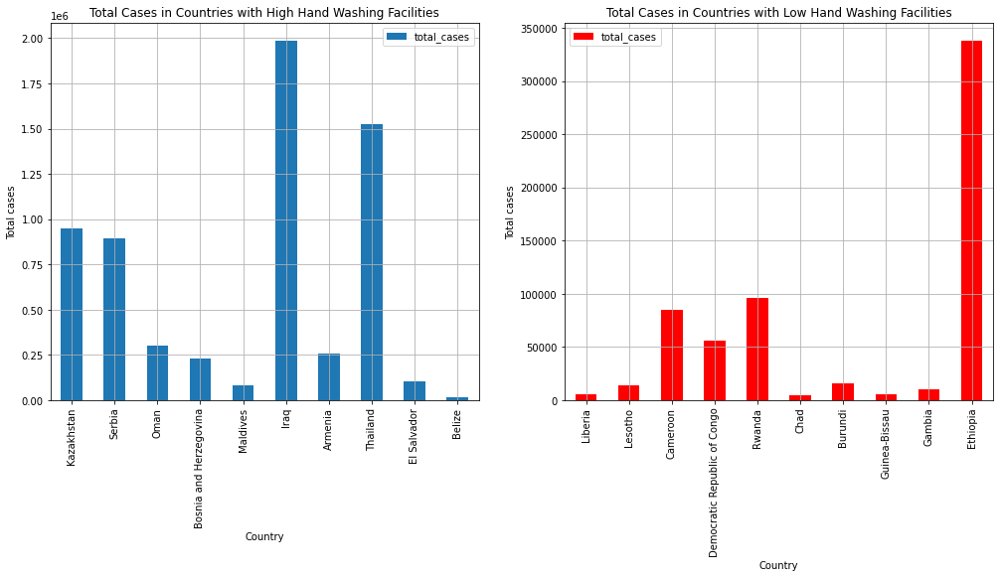

In [32]:
# Visualize 
fig, axes = plt.subplots(1, 2,figsize=(17, 7))
high_handwash_facility.plot(kind="bar",ax=axes[0],x="Country",y="total_cases",ylabel="Total cases",
                            title="Total Cases in Countries with High Hand Washing Facilities",grid=True)

low_handwash_facility.plot(kind="bar",ax=axes[1],x="Country",y="total_cases",color="red",ylabel="Total cases",
                           title="Total Cases in Countries with Low Hand Washing Facilities",grid=True)

### Top 10 Countries with High Hospital Beds Per Thousand Rate

In [33]:
hospital_beds = country_total.sort_values("hospital_beds_per_thousand",axis=0,ascending=False).reset_index(drop=True)[:10]
display("Top 10 Countries with High Hospital Beds Per Thousand Rate",hospital_beds)
fig = px.bar(hospital_beds,x="Country",y="Case_fatality_ratio",title="Top 10 Countries with High Hospital Beds Per Thousand Rate",
             hover_data=["hospital_beds_per_thousand","Mortality_ratio"],color="Case_fatality_ratio")
fig.show()

'Top 10 Countries with High Hospital Beds Per Thousand Rate'

,Country,total_cases,total_deaths,population,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,...,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,Case_fatality_ratio,Mortality_ratio,test_rate
0,Monaco,3300.0,33.0,39520.0,NaN,NaN,49980.0,26672.0,23308.0,NaN,...,5.46,NaN,NaN,NaN,13.800,86.75,NaN,0.010000,0.000835,NaN
1,Japan,1688929.0,17397.0,126050796.0,22979541.0,182.304,156559895.0,85829323.0,70730572.0,NaN,...,5.72,11.2,33.7,NaN,13.050,84.63,0.919,0.010301,0.000138,0.182304
2,South Korea,295132.0,2434.0,51305184.0,13116349.0,255.653,49641439.0,37132188.0,13929897.0,NaN,...,6.80,6.2,40.9,NaN,12.270,83.03,0.916,0.008247,0.000047,0.255653
3,Belarus,524248.0,4054.0,9442867.0,8238914.0,872.501,3389520.0,1877399.0,1512121.0,NaN,...,5.18,10.5,46.1,NaN,11.000,74.79,0.823,0.007733,0.000429,0.872501
4,Ukraine,2476848.0,58895.0,43466822.0,12593275.0,289.722,11979985.0,6624026.0,5355959.0,NaN,...,7.11,13.5,47.4,NaN,8.800,72.06,0.779,0.023778,0.001355,0.289722
5,Russia,7248572.0,197834.0,145912022.0,187347905.0,1283.979,88567925.0,47285157.0,41282768.0,NaN,...,6.18,23.4,58.3,NaN,8.050,72.58,0.824,0.027293,0.001356,1.283979
6,Germany,4183672.0,93310.0,83900471.0,72301440.0,861.752,106623426.0,56197198.0,53005569.0,543573.0,...,8.31,28.2,33.1,NaN,8.000,81.33,0.947,0.022303,0.001112,0.861752
7,Bulgaria,489423.0,20350.0,6896655.0,4627161.0,670.928,2494575.0,1089066.0,1298936.0,NaN,...,5.81,30.1,44.4,NaN,7.454,75.05,0.816,0.041580,0.002951,0.670928
8,Austria,730403.0,10943.0,9043072.0,83242754.0,9205.141,10759454.0,5685519.0,5371741.0,NaN,...,6.35,28.4,30.9,NaN,7.370,81.54,0.922,0.014982,0.001210,9.205141
9,Hungary,819547.0,30145.0,9634162.0,6355050.0,659.637,9249943.0,5873523.0,5615273.0,691000.0,...,7.55,26.8,34.8,NaN,7.020,76.88,0.854,0.036783,0.003129,0.659637


### Impact of Covid19 in Countries with high Cardiovascular Death Rate  and  Diabeties Privelence

In [34]:
# Top 10 Countries with High Cardiovascular Death Rates
cardiovasc_death_rate = country_total.sort_values("cardiovasc_death_rate",axis=0,ascending=False)[:10]
# Top 10 Countries with High Diabeties Privelence Rates
diabetes_prevalence = country_total.sort_values("diabetes_prevalence",axis=0,ascending=False)[:10]

fig = make_subplots(rows=1, cols=2,subplot_titles=("Case fatality ratio of high cardiovasc death rate countries",
                                                   "Case fatality ratio of high diabetes prevalence countries"))

fig.add_trace(go.Bar(x=cardiovasc_death_rate["Country"],y=cardiovasc_death_rate["Case_fatality_ratio"]),1,1)
fig.add_trace(go.Bar(x=diabetes_prevalence["Country"],y=diabetes_prevalence["Case_fatality_ratio"]),1,2)

fig.update_yaxes(title_text="Case_fatality_ratio", row=1, col=1)
fig.update_yaxes(title_text="Case_fatality_ratio", row=1, col=2)
fig.update_xaxes(title_text="Country with high cardiovasc death rate", row=1, col=1)
fig.update_xaxes(title_text="Country with high diabetes prevalence", row=1, col=2)
fig.show()

### Covid Cases and Deaths in Top 10 Counties with Extreme Poverty 

In [35]:
extreme_poverty = country_total.sort_values("extreme_poverty",axis=0,ascending=False).reset_index(drop=True)[:10]
display("Top 10 Countries with  Extreme Poverty Rate",extreme_poverty[["Country","extreme_poverty","total_cases","total_deaths"]])

fig = px.bar(extreme_poverty,x=["total_cases","total_deaths"],y="Country",height=700,barmode="group",
             title="Covid Cases & Deaths in Top 10 Countries with Extreme Poverty Rate",
             hover_data=["human_development_index"],orientation="h",labels={"value":"Count"})
fig.show()

'Top 10 Countries with  Extreme Poverty Rate'

,Country,extreme_poverty,total_cases,total_deaths
0,Madagascar,77.6,42898.0,958.0
1,Democratic Republic of Congo,77.1,56463.0,1068.0
2,Burundi,71.7,16356.0,38.0
3,Malawi,71.4,61453.0,2269.0
4,Guinea-Bissau,67.1,6094.0,133.0
5,Mozambique,62.9,150370.0,1907.0
6,Lesotho,59.6,14395.0,403.0
7,Zambia,57.5,208715.0,3641.0
8,Rwanda,56.0,96337.0,1233.0
9,Sierra Leone,52.2,6393.0,121.0


### Covid Cases and Deaths in Counties with high Human Development index

In [36]:
hdi = country_total.sort_values("human_development_index", axis =0 ,ascending=False).reset_index(drop=True)[:10]
display("TOp 10 Countries with High Human Development Index",hdi[["Country","human_development_index","total_cases","total_deaths"]])


'TOp 10 Countries with High Human Development Index'

,Country,human_development_index,total_cases,total_deaths
0,Norway,0.957,185330.0,850.0
1,Switzerland,0.955,831881.0,11034.0
2,Ireland,0.955,380720.0,5209.0
3,Iceland,0.949,11594.0,33.0
4,Hong Kong,0.949,12169.0,213.0
5,Germany,0.947,4183672.0,93310.0
6,Sweden,0.945,1148641.0,14813.0
7,Netherlands,0.944,2029409.0,18541.0
8,Australia,0.944,93942.0,1208.0
9,Denmark,0.940,357571.0,2640.0


In [37]:
# Visualize
fig = px.bar(hdi,x = "Country", y = ["total_cases","total_deaths"],barmode = "group",
             hover_data = ["human_development_index","life_expectancy"],title = "Covid19 & Human Development Index",
             labels = {"Country":"Country (HDI Ranking)"})

fig.show()

### Sort Countries with High Male and Female smokeing Rates

In [38]:
male_smoker = country_total.sort_values("male_smokers", axis=0,ascending = False).reset_index(drop=True)[:10]
female_smoker = country_total.sort_values("female_smokers",axis=0, ascending = False).reset_index(drop=True)[:10]
display("Counties with High Rate of Male Smokers",male_smoker[["Country","male_smokers","total_cases","total_deaths"]])
display("Counties with High Rate of female Smokers",female_smoker[["Country","female_smokers","total_cases","total_deaths"]])

'Counties with High Rate of Male Smokers'

,Country,male_smokers,total_cases,total_deaths
0,Timor,78.1,19264.0,109.0
1,Indonesia,76.1,4201559.0,141114.0
2,Tunisia,65.8,703059.0,24676.0
3,Kiribati,58.9,2.0,NaN
4,Russia,58.3,7248572.0,197834.0
5,Georgia,55.5,602065.0,8711.0
6,Maldives,55.0,84103.0,229.0
7,Lesotho,53.9,14395.0,403.0
8,Cuba,53.3,832286.0,7048.0
9,Cyprus,52.7,117759.0,551.0


'Counties with High Rate of female Smokers'

,Country,female_smokers,total_cases,total_deaths
0,Montenegro,44.0,128377.0,1879.0
1,Serbia,37.7,893023.0,7926.0
2,Kiribati,35.9,2.0,NaN
3,Greece,35.3,641022.0,14606.0
4,Croatia,34.3,396470.0,8554.0
5,Chile,34.2,1649409.0,37410.0
6,Czechia,30.5,1687973.0,30448.0
7,Bosnia and Herzegovina,30.2,230212.0,10379.0
8,France,30.1,7068630.0,117062.0
9,Bulgaria,30.1,489423.0,20350.0


### Visualize Case Fatality Rate in Country with High Male Smoker & Female Smoker

<AxesSubplot:title={'center':'Case Fatality Rate in Countries with High Female Smokers'}, xlabel='Country', ylabel='Case fatality ratio'>

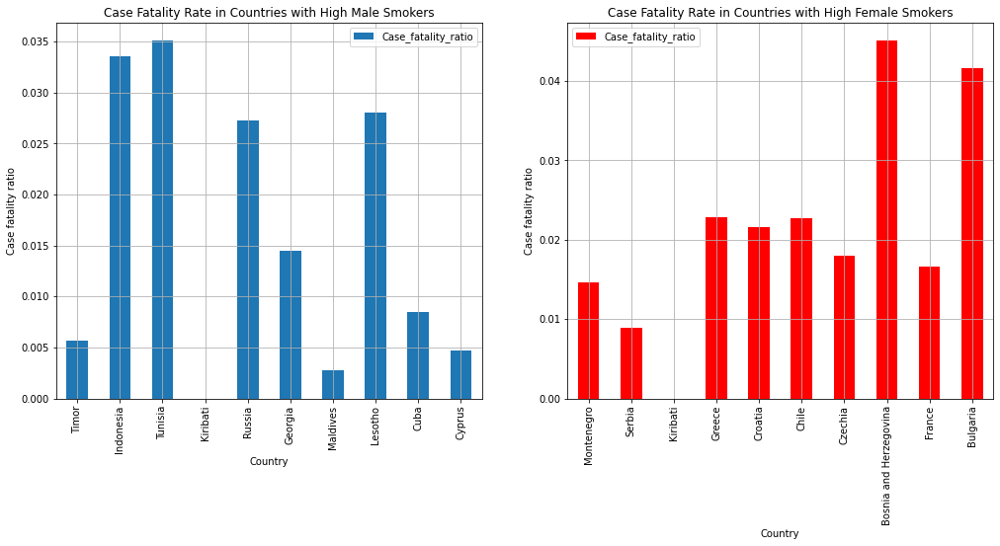

In [39]:
fig, axes = plt.subplots(1, 2,figsize=(17, 7))
male_smoker.plot(kind ="bar",ax=axes[0],x="Country",y="Case_fatality_ratio",ylabel="Case fatality ratio",
                            title="Case Fatality Rate in Countries with High Male Smokers",grid=True)

female_smoker.plot(kind ="bar",ax=axes[1],x="Country",y="Case_fatality_ratio",color="red",ylabel="Case fatality ratio",
                           title="Case Fatality Rate in Countries with High Female Smokers",grid=True)


## Vaccination Data  of Countries

In [40]:
#Countries with high people vaccinated per hundred 
country_vaccine = country_total.sort_values("total_vaccinations_per_hundred", axis = 0, ascending = False).reset_index(drop=True)[:10]  
display("COUNTRIES HAVING MOST PEOPLE VACCINATED PER HUNDRED :",country_vaccine)

fig = px.bar(country_vaccine, x="Country", y=["total_vaccinations_per_hundred","population_density"], 
             barmode="group",title="Total Vaccinations Per Hundred",labels={"value":"Count"})
fig.show()

'COUNTRIES HAVING MOST PEOPLE VACCINATED PER HUNDRED :'

,Country,total_cases,total_deaths,population,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,...,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,Case_fatality_ratio,Mortality_ratio,test_rate
0,United Arab Emirates,733972.0,2083.0,9991083.0,80875407.0,8094.759,19713423.0,9178234.0,8110078.0,NaN,...,17.26,1.2,37.4,NaN,1.200,77.97,0.890,0.002838,0.000208,8.094759
1,Uruguay,388191.0,6049.0,3485152.0,3518631.0,1009.606,6127982.0,2724792.0,2561804.0,841386.0,...,6.93,14.0,19.9,NaN,2.800,77.91,0.817,0.015583,0.001736,1.009606
2,Israel,1254351.0,7611.0,8789776.0,26064794.0,2965.354,14840739.0,6081273.0,5605487.0,3153979.0,...,6.74,15.4,35.4,NaN,2.990,82.97,0.919,0.006068,0.000866,2.965354
3,Cuba,832286.0,7048.0,11317498.0,5296762.0,468.015,19073986.0,8635392.0,4729445.0,11474.0,...,8.27,17.1,53.3,85.198,5.200,78.80,0.783,0.008468,0.000623,0.468015
4,Chile,1649409.0,37410.0,19212362.0,21012184.0,1093.680,31192299.0,14849474.0,14068332.0,2837586.0,...,8.46,34.2,41.5,NaN,2.110,80.18,0.851,0.022681,0.001947,1.093680
5,Iceland,11594.0,33.0,343360.0,620997.0,1808.589,551110.0,281440.0,275493.0,48414.0,...,5.31,14.3,15.2,NaN,2.910,82.99,0.949,0.002846,0.000096,1.808589
6,Qatar,236016.0,604.0,2930524.0,2610510.0,890.800,4681668.0,2360308.0,2218292.0,NaN,...,16.52,0.8,26.9,NaN,1.200,80.23,0.848,0.002559,0.000206,0.890800
7,Malta,37048.0,456.0,514564.0,1211456.0,2354.335,814067.0,419604.0,419078.0,5798.0,...,8.83,20.9,30.2,NaN,4.485,82.53,0.895,0.012308,0.000886,2.354335
8,Portugal,1064876.0,17938.0,10167923.0,18007442.0,1771.005,15888462.0,8912232.0,8592804.0,NaN,...,9.85,16.3,30.0,NaN,3.390,82.05,0.864,0.016845,0.001764,1.771005
9,Singapore,82860.0,70.0,5896684.0,19108195.0,3240.498,9199565.0,4671857.0,4560622.0,NaN,...,10.99,5.2,28.3,NaN,2.400,83.62,0.938,0.000845,0.000012,3.240498


### Top 10 Countries with Most Number of Vaccinations Administered

In [41]:
country_total_vaccination = country_total.sort_values("total_vaccinations", axis = 0, ascending = False)[:10]
top_10_total_vaccination=country_total_vaccination[country_total_vaccination.columns[:10]].reset_index(drop=True)
display("Top 10 Countries with Most Number of Vaccinations",top_10_total_vaccination)

fig = px.bar(country_total_vaccination,x="Country", y=["total_vaccinations","people_vaccinated","people_fully_vaccinated"],
             barmode="group",title="Top 10 Countries with Most Number of Vaccinations Administered",labels={"value":"Count"})
fig.show()

'Top 10 Countries with Most Number of Vaccinations'

,Country,total_cases,total_deaths,population,total_tests,total_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters
0,China,96011.0,4639.0,1.444216e+09,160000000.0,110.787,2.190792e+09,1.100842e+09,1.022207e+09,NaN
1,India,33594803.0,446368.0,1.393409e+09,553621766.0,397.315,8.372398e+08,6.212091e+08,2.160308e+08,NaN
2,United States,42672241.0,684349.0,3.329151e+08,558104328.0,1676.417,3.878217e+08,2.125643e+08,1.825873e+08,2370839.0
3,Brazil,21308178.0,592964.0,2.139934e+08,31716527.0,148.213,2.271649e+08,1.479084e+08,8.381664e+07,NaN
4,Japan,1688929.0,17397.0,1.260508e+08,22979541.0,182.304,1.565599e+08,8.582932e+07,7.073057e+07,NaN
5,Indonesia,4201559.0,141114.0,2.763618e+08,24548760.0,88.828,1.302285e+08,8.324813e+07,4.698035e+07,NaN
6,Turkey,6960267.0,62524.0,8.504274e+07,82744951.0,972.981,1.068937e+08,5.318511e+07,4.300219e+07,10706419.0
7,Germany,4183672.0,93310.0,8.390047e+07,72301440.0,861.752,1.066234e+08,5.619720e+07,5.300557e+07,543573.0
8,Mexico,3608976.0,274139.0,1.302622e+08,9864382.0,75.727,9.752371e+07,6.291116e+07,4.324866e+07,NaN
9,United Kingdom,7601598.0,136156.0,6.820711e+07,263671147.0,3865.743,9.327422e+07,4.867415e+07,4.460007e+07,NaN


### Top 10 Countries with Most Number of Booster Shot Vaccinations

In [42]:
total_booster = country_total.sort_values("total_boosters", axis = 0, ascending = False)[:10]
top_10_total_booster = total_booster[["Country","population","people_fully_vaccinated","total_boosters"]].reset_index(drop=True)
display("Top 10 Countries With Maximum Booster Shots Administered",top_10_total_booster)

fig = px.bar(top_10_total_booster, x="Country", y=["total_boosters","people_fully_vaccinated"], barmode="group",
             title="Top 10 Countries with Most Number of Booster Shot Vaccinations",labels={"value":"Count"})
fig.show()

'Top 10 Countries With Maximum Booster Shots Administered'

,Country,population,people_fully_vaccinated,total_boosters
0,Turkey,85042736.0,43002194.0,10706419.0
1,Israel,8789776.0,5605487.0,3153979.0
2,Chile,19212362.0,14068332.0,2837586.0
3,United States,332915074.0,182587334.0,2370839.0
4,Dominican Republic,10953714.0,4849827.0,877668.0
5,Cambodia,16946446.0,10706838.0,855045.0
6,Uruguay,3485152.0,2561804.0,841386.0
7,Hungary,9634162.0,5615273.0,691000.0
8,Thailand,69950844.0,15899158.0,622748.0
9,Germany,83900471.0,53005569.0,543573.0


### Top 10 Countries with Highest Case Fatality Rate 

In [43]:
fig = px.bar(country_total.sort_values("Case_fatality_ratio", ascending=False)[:10], 
             x="Case_fatality_ratio", y="Country",
             title="Top 10 Countries with Highest Case Fatality Rate ",height=600, text="Case_fatality_ratio",
             orientation="h",hover_data=["population"], color="Case_fatality_ratio")
fig.update_layout(yaxis={"categoryorder":"total ascending"})
fig.show()

### Top 10  Countries with Highest Mortality Rate

In [44]:
fig = px.bar(country_cases_sorted.sort_values("Mortality_ratio", ascending=False)[:10], x="Mortality_ratio", 
             y="Country",title="Top 10 Countries with Highest Mortality Rate",height=600, text="Mortality_ratio", 
             orientation="h",hover_data=["population"], color="Mortality_ratio")
fig.update_layout(yaxis={'categoryorder':'total ascending'})
fig.show()

# Indian Covid_19 Data 

In [56]:
india_data = data.loc[data["location"]=="India"].reset_index(drop=True)

indian_dataset=india_data[["location","date","total_cases","new_cases","total_deaths","new_deaths",
                           "total_tests","new_tests","total_vaccinations","new_vaccinations","people_vaccinated",
                           "people_fully_vaccinated","total_boosters","stringency_index"]]
display("Indian Covid_19 Data",indian_dataset.head(10))

'Indian Covid_19 Data'

,location,date,total_cases,new_cases,total_deaths,new_deaths,total_tests,new_tests,total_vaccinations,new_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,stringency_index
0,India,2020-01-30,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
1,India,2020-01-31,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
2,India,2020-02-01,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
3,India,2020-02-02,2.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
4,India,2020-02-03,3.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
5,India,2020-02-04,3.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
6,India,2020-02-05,3.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
7,India,2020-02-06,3.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
8,India,2020-02-07,3.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19
9,India,2020-02-08,3.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.19


### Total Cases and Deaths in India

In [46]:
fig=px.line(india_data,x="date",y=["total_cases","total_deaths"],title="Total Cases and Deaths in India",
            labels={"value":"Count"})
fig.show()

### Daily Cases and Deaths in India

In [47]:
fig=px.line(india_data,x="date",y=["new_cases","new_deaths"],title="Daily Cases and Deaths in India",
            labels={"value":"Count"})
fig.show()

### Total Testing for Covid_19 in India

In [48]:
fig=px.line(india_data,x="date",y=["total_tests"],title="Total Testing for Covid_19 in India",
            labels={"value":"Count"})
fig.show()

### Number of Covid_19 Testings Daily in India

In [49]:
fig=px.line(india_data,x="date",y=["new_tests"],title="Daily Testing for Covid_19 in India",
            labels={"value":"Count"})
fig.show()

In [50]:
# Grouping Data from Starting Date of Vaccination 
start_date = "2021-01-16"
end_date = "2021-09-23"
mask = (indian_dataset['date'] > start_date) & (indian_dataset['date'] <= end_date)
vaccination_start_india = indian_dataset.loc[mask]
vaccination_start_india.reset_index(drop=True,inplace=True)
display("Vaccination Data in India ",vaccination_start_india.head(10))

'Vaccination Data in India '

,location,date,total_cases,new_cases,total_deaths,new_deaths,total_tests,new_tests,total_vaccinations,new_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,stringency_index
0,India,2021-01-17,10571773.0,13788.0,152419.0,145.0,186544868.0,779377.0,224301.0,33120.0,224301.0,NaN,NaN,68.98
1,India,2021-01-18,10581823.0,10050.0,152556.0,137.0,187093036.0,548168.0,454049.0,229748.0,454049.0,NaN,NaN,68.98
2,India,2021-01-19,10595639.0,13816.0,152718.0,162.0,187802827.0,709791.0,674835.0,220786.0,674835.0,NaN,NaN,68.98
3,India,2021-01-20,10610883.0,15244.0,152869.0,151.0,188566947.0,764120.0,806484.0,131649.0,806484.0,NaN,NaN,68.98
4,India,2021-01-21,10625428.0,14545.0,153032.0,163.0,189347782.0,780835.0,1043534.0,237050.0,1043534.0,NaN,NaN,68.98
5,India,2021-01-22,10639684.0,14256.0,153184.0,152.0,190148024.0,800242.0,1390592.0,347058.0,1390592.0,NaN,NaN,68.98
6,India,2021-01-23,10654533.0,14849.0,153339.0,155.0,190985119.0,837095.0,1582201.0,191609.0,1582201.0,NaN,NaN,68.98
7,India,2021-01-24,10667736.0,13203.0,153470.0,131.0,191766871.0,781752.0,1615504.0,33303.0,1615504.0,NaN,NaN,68.98
8,India,2021-01-25,10676838.0,9102.0,153587.0,117.0,192337117.0,570246.0,2023809.0,408305.0,2023809.0,NaN,NaN,68.98
9,India,2021-01-26,10689527.0,12689.0,153724.0,137.0,193062694.0,725577.0,2029480.0,5671.0,2029480.0,NaN,NaN,67.13


### Daily Vaccinations in India

In [51]:
fig=px.line(vaccination_start_india,x="date",y="new_vaccinations",title="Daily Vaccination in India",
            labels={"value":"Count"})
fig.show()

###  Vaccination Doses Administered  in India

In [52]:
fig=px.line(vaccination_start_india,x="date",y=["total_vaccinations","people_vaccinated","people_fully_vaccinated"],
            title="Vaccination Doses Administered in India",labels={"value":"Count"})
fig.show()

### Impact of Stringency Index on the Rate of Covid Cases and Deaths in India

In [53]:
fig = px.scatter(indian_dataset, x=["new_cases","new_deaths"], y="stringency_index",
                 title="Impact of Stringency Index on the Number of Covid Cases and Deaths in India")
fig.show()

### Comparing Daily Cases in India and United States

In [54]:
usa_data = data.loc[data["location"]=="United States"].reset_index()
usa_data = usa_data[["date","new_cases"]]
usa_df = usa_data.rename(columns={"new_cases": "usa_daily_cases"})
india_cases = indian_dataset[["date","new_cases"]]
india_df = india_cases.rename(columns={"new_cases": "india_daily_cases"})

compare_data = pd.concat([usa_df,india_df])

fig=px.line(compare_data,x="date",y=["usa_daily_cases","india_daily_cases"],
            title="Comparing Daily Cases in India and USA",labels={"value":"Count"})
fig.show()
